# Exploratory Data Analysis

## Table of Contents

1. [Overview](#overview)
2. [Column Data](#)
3. [Importing Libraries](#)
4. [Loading Data](#)
5. [Data Insights](#)
6. [Frequency Distributions](#frequency-distributions)
7. [Conclusion](#conclusion)

# Overview
## Description:
Banks earn a major revenue from lending loans. But it is often associated with risk. The borrower's may default on the loan. To mitigate this issue, the banks have decided to use Machine Learning to overcome this issue. They have collected past data on the loan borrowers & would like you to develop a strong ML Model to classify if any new borrower is likely to default or not.

The dataset is enormous & consists of multiple deteministic factors like borrowe's income, gender, loan pupose etc. The dataset is subject to strong multicollinearity & empty values. Can you overcome these factors & build a strong classifier to predict defaulters?

## Acknowledgements:
This dataset has been referred from Kaggle.

## Objective:
- Understand the Dataset & cleanup (if required).
- Build classification model to predict weather the loan borrower will default or not.
- Also fine-tune the hyperparameters & compare the evaluation metrics of vaious classification algorithms.


### Meaning for each data

1. id - ID of customer
2. year - Year
3. loan_limit - 
4. gender - gender
5. approv_in_adv - approved in advance
6. loan_type - loan type
7. loan_purpose - loan purpose
8. credit_worthiness - credit worthiness
9. open_credit - a financial arrangement between a lender and a borrower that allows the latter to access credit repeatedly up to a specific maximum limit
10. business_or_commercial - type of customer
11. loan_amount - amount
12. rate_of_interest - interest
13. interest_rate_spread - interest given to loan vs average interest given by banks
14. upfront_charges - downpayment
15. term - length of payment (in terms of days)
16. neg_ammortization - Negative amortization means that even when you pay, the amount you owe will still go up because you are not paying enough to cover the interest.
17. interest_only - 
18. lump_sum_payment - paid in full ??
19. property_value - 
20. construction_type - 
21. occupancy_type - 
22. secured_by - leverage
23. total_units - 
24. income - 
25. credit_type - 
26. credit_score -  rate of consumers credit worthiness
27. co-applicant_credit_type - 
28. age - 
29. submission_of_application - 
30. ltv
31. region
32. security_type
33. status
34. dtir1


In [148]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# Loading Data

In [149]:
df = pd.read_csv('./Loan_Default.csv')
df.head()

,ID,year,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,...,credit_type,Credit_Score,co-applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1
0,24890,2019,cf,Sex Not Available,nopre,type1,p1,l1,nopc,nob/c,...,EXP,758,CIB,25-34,to_inst,98.728814,south,direct,1,45.0
1,24891,2019,cf,Male,nopre,type2,p1,l1,nopc,b/c,...,EQUI,552,EXP,55-64,to_inst,NaN,North,direct,1,NaN
2,24892,2019,cf,Male,pre,type1,p1,l1,nopc,nob/c,...,EXP,834,CIB,35-44,to_inst,80.019685,south,direct,0,46.0
3,24893,2019,cf,Male,nopre,type1,p4,l1,nopc,nob/c,...,EXP,587,CIB,45-54,not_inst,69.376900,North,direct,0,42.0
4,24894,2019,cf,Joint,pre,type1,p1,l1,nopc,nob/c,...,CRIF,602,EXP,25-34,not_inst,91.886544,North,direct,0,39.0



### Unique data for column sets

```
for column in df:
    print(column, df[column].unique())
```

1. _loan_limit_ ['cf' nan 'ncf']
2. _gender_ ['Sex Not Available' 'Male' 'Joint' 'Female']
3. _approv_in_adv_ ['nopre' 'pre' nan]
4. _loan_type_ ['type1' 'type2' 'type3']
5. _loan_purpose_ ['p1' 'p4' 'p3' 'p2' nan]
6. _Credit_Worthiness_ ['l1' 'l2']
7. _open_credit_ ['nopc' 'opc']
8. _business_or_commercial_ ['nob/c' 'b/c']
9. _neg_ammortization_ ['not_neg' 'neg_amm' nan]
10. _interest_only_ ['not_int' 'int_only']
11. _lump_sum_payment_ ['not_lpsm' 'lpsm']
12. _construction_type_ ['sb' 'mh']
13. _occupancy_type_ ['pr' 'sr' 'ir']
14. _secured_by_ ['home' 'land']
15. _total_units_ ['1U' '2U' '3U' '4U']
16. _credit_type_ ['EXP' 'EQUI' 'CRIF' 'CIB']
17. _co_-applicant_credit_type ['CIB' 'EXP']
18. _submission_of_application_ ['to_inst' 'not_inst' nan]
19. _region_ ['south' 'north' 'central' 'north-east']
20. _security_type_ ['direct' 'Indriect']
21. _status_ [ 1.  0. nan]

In [150]:
df.shape

(148670, 34)


df.columns = df.columns.str.lower()
df['region'] = df['region'].str.lower()
df['security_type'] = df['security_type'].str.lower()

In [151]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 148670 entries, 0 to 148669
Data columns (total 34 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   ID                         148670 non-null  int64  
 1   year                       148670 non-null  int64  
 2   loan_limit                 145326 non-null  object 
 3   Gender                     148670 non-null  object 
 4   approv_in_adv              147762 non-null  object 
 5   loan_type                  148670 non-null  object 
 6   loan_purpose               148536 non-null  object 
 7   Credit_Worthiness          148670 non-null  object 
 8   open_credit                148670 non-null  object 
 9   business_or_commercial     148670 non-null  object 
 10  loan_amount                148670 non-null  int64  
 11  rate_of_interest           112231 non-null  float64
 12  Interest_rate_spread       112031 non-null  float64
 13  Upfront_charges            10

In [152]:
df.describe()

,ID,year,loan_amount,rate_of_interest,Interest_rate_spread,Upfront_charges,term,property_value,income,Credit_Score,LTV,Status,dtir1
count,148670.000000,148670.0,1.486700e+05,112231.000000,112031.000000,109028.000000,148629.000000,1.335720e+05,139520.000000,148670.000000,133572.000000,148670.000000,124549.000000
mean,99224.500000,2019.0,3.311177e+05,4.045476,0.441656,3224.996127,335.136582,4.978935e+05,6957.338876,699.789103,72.746457,0.246445,37.732932
std,42917.476598,0.0,1.839093e+05,0.561391,0.513043,3251.121510,58.409084,3.599353e+05,6496.586382,115.875857,39.967603,0.430942,10.545435
min,24890.000000,2019.0,1.650000e+04,0.000000,-3.638000,0.000000,96.000000,8.000000e+03,0.000000,500.000000,0.967478,0.000000,5.000000
25%,62057.250000,2019.0,1.965000e+05,3.625000,0.076000,581.490000,360.000000,2.680000e+05,3720.000000,599.000000,60.474860,0.000000,31.000000
50%,99224.500000,2019.0,2.965000e+05,3.990000,0.390400,2596.450000,360.000000,4.180000e+05,5760.000000,699.000000,75.135870,0.000000,39.000000
75%,136391.750000,2019.0,4.365000e+05,4.375000,0.775400,4812.500000,360.000000,6.280000e+05,8520.000000,800.000000,86.184211,0.000000,45.000000
max,173559.000000,2019.0,3.576500e+06,8.000000,3.357000,60000.000000,360.000000,1.650800e+07,578580.000000,900.000000,7831.250000,1.000000,61.000000


In [153]:
df.drop_duplicates(inplace=True)

In [154]:
df.isna().sum()

ID                               0
year                             0
loan_limit                    3344
Gender                           0
approv_in_adv                  908
loan_type                        0
loan_purpose                   134
Credit_Worthiness                0
open_credit                      0
business_or_commercial           0
loan_amount                      0
rate_of_interest             36439
Interest_rate_spread         36639
Upfront_charges              39642
term                            41
Neg_ammortization              121
interest_only                    0
lump_sum_payment                 0
property_value               15098
construction_type                0
occupancy_type                   0
Secured_by                       0
total_units                      0
income                        9150
credit_type                      0
Credit_Score                     0
co-applicant_credit_type         0
age                            200
submission_of_applic

In [155]:

df.columns = df.columns.str.lower()
df['region'] = df['region'].str.lower()
df['security_type'] = df['security_type'].str.lower()

Separate status 1 and status 0 for better analysis

In [156]:
status_0 = df.loc[df.status == 0]
status_1 = df.loc[df.status == 1]

In [183]:

status_0.describe()

,id,year,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,property_value,income,credit_score,ltv,status,dtir1
count,112031.000000,112031.0,1.120310e+05,112031.000000,112031.000000,108875.000000,112005.000000,1.120290e+05,104120.000000,112031.000000,112029.000000,112031.0,104220.000000
mean,99182.699530,2019.0,3.349908e+05,4.044931,0.441656,3227.328554,335.144592,5.056061e+05,7204.014214,699.523793,72.064757,0.0,37.369267
std,42925.111042,0.0,1.749166e+05,0.561356,0.513043,3251.673989,58.824650,3.427845e+05,6201.339600,115.674510,41.768899,0.0,10.027197
min,24892.000000,2019.0,2.650000e+04,0.000000,-3.638000,0.000000,96.000000,8.000000e+03,0.000000,500.000000,2.072943,0.0,5.000000
25%,61964.500000,2019.0,2.065000e+05,3.625000,0.076000,584.390000,360.000000,2.880000e+05,4020.000000,599.000000,59.970817,0.0,31.000000
50%,99222.000000,2019.0,3.065000e+05,3.990000,0.390400,2600.000000,360.000000,4.280000e+05,6000.000000,699.000000,74.504405,0.0,38.000000
75%,136306.000000,2019.0,4.465000e+05,4.375000,0.775400,4815.315000,360.000000,6.380000e+05,8760.000000,800.000000,85.201149,0.0,44.000000
max,173559.000000,2019.0,3.006500e+06,8.000000,3.357000,60000.000000,360.000000,9.268000e+06,377220.000000,900.000000,7831.250000,0.0,61.000000


In [184]:
status_1.describe()

,id,year,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,property_value,income,credit_score,ltv,status,dtir1
count,36639.000000,36639.0,3.663900e+04,200.000000,0.0,153.000000,36624.000000,2.154300e+04,35400.000000,36639.000000,21543.000000,36639.0,20329.000000
mean,99352.313218,2019.0,3.192752e+05,4.350500,NaN,1565.237974,335.112085,4.577860e+05,6231.806780,700.600344,76.291468,1.0,39.597324
std,42894.457217,0.0,2.085768e+05,0.495546,NaN,2299.820513,57.120208,4.362550e+05,7247.649876,116.487189,28.580217,0.0,12.716828
min,24890.000000,2019.0,1.650000e+04,3.125000,NaN,0.000000,96.000000,8.000000e+03,0.000000,500.000000,0.967478,1.0,5.000000
25%,62304.000000,2019.0,1.765000e+05,3.990000,NaN,0.000000,360.000000,2.280000e+05,3000.000000,599.500000,64.273172,1.0,32.000000
50%,99233.000000,2019.0,2.765000e+05,4.312500,NaN,687.850000,360.000000,3.480000e+05,4860.000000,700.000000,79.362416,1.0,42.000000
75%,136669.000000,2019.0,4.165000e+05,4.750000,NaN,2310.750000,360.000000,5.580000e+05,7620.000000,803.000000,90.948276,1.0,49.000000
max,173553.000000,2019.0,3.576500e+06,5.500000,NaN,15584.000000,360.000000,1.650800e+07,578580.000000,900.000000,2956.250000,1.0,61.000000


In [192]:
status_1.isna().sum()

id                               0
year                             0
loan_limit                     881
gender                           0
approv_in_adv                  241
loan_type                        0
loan_purpose                    35
credit_worthiness                0
open_credit                      0
business_or_commercial           0
loan_amount                      0
rate_of_interest             36439
interest_rate_spread         36639
upfront_charges              36486
term                            15
neg_ammortization               32
interest_only                    0
lump_sum_payment                 0
property_value               15096
construction_type                0
occupancy_type                   0
secured_by                       0
total_units                      0
income                        1239
credit_type                      0
credit_score                     0
co-applicant_credit_type         0
age                            200
submission_of_applic

In [194]:

status_0.isna().sum()

id                              0
year                            0
loan_limit                   2463
gender                          0
approv_in_adv                 667
loan_type                       0
loan_purpose                   99
credit_worthiness               0
open_credit                     0
business_or_commercial          0
loan_amount                     0
rate_of_interest                0
interest_rate_spread            0
upfront_charges              3156
term                           26
neg_ammortization              89
interest_only                   0
lump_sum_payment                0
property_value                  2
construction_type               0
occupancy_type                  0
secured_by                      0
total_units                     0
income                       7911
credit_type                     0
credit_score                    0
co-applicant_credit_type        0
age                             0
submission_of_application       0
ltv           

# Frequency Distributions
[Table of Contents](#table-of-contents)

In [157]:

status_0.sort_values(by="age").age.plot(kind='hist', backend='plotly')

In [158]:

status_1.sort_values(by="age").age.plot(kind='hist', backend='plotly')

Text(0, 0.5, 'count')

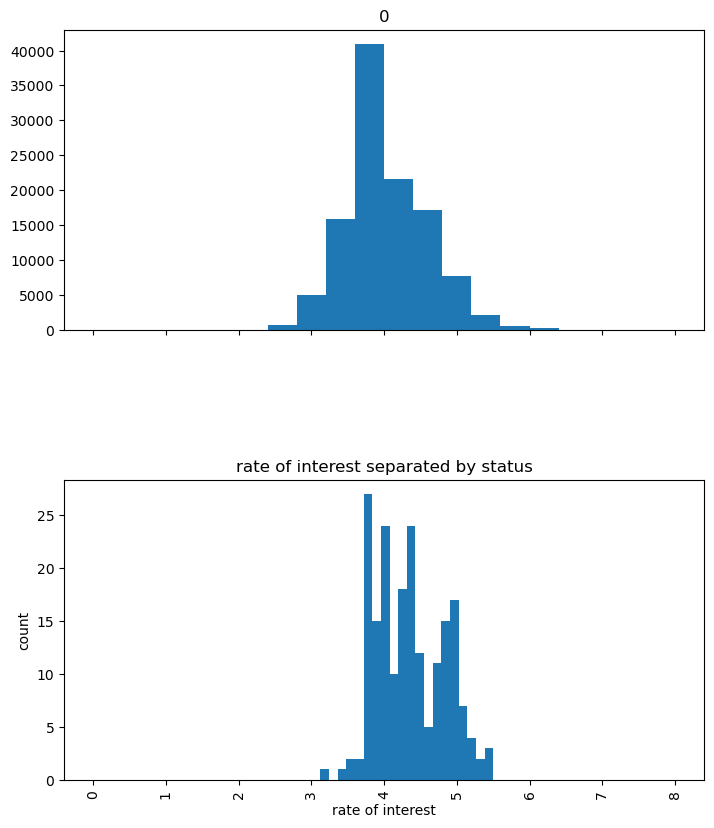

In [159]:

df.hist(column='rate_of_interest', by='status', bins=20, grid=False,
        figsize=(8, 10), layout=(2, 1), sharex=True, 
        )
plt.title("rate of interest separated by status")
plt.xlabel("rate of interest")
plt.ylabel("count")

In [188]:
status_0.loan_amount.plot(kind='hist',backend='plotly')

In [187]:

status_1.loan_amount.plot(kind='hist',backend='plotly')

In [162]:

status_1.gender.plot(kind='hist',backend='plotly')

In [163]:

status_0.gender.plot(kind='hist',backend='plotly')

In [164]:
status_1.credit_score.plot(kind='hist',backend='plotly')

In [165]:

status_0.credit_score.plot(kind='hist',backend='plotly')

In [185]:

status_0.income.plot(kind='hist',backend='plotly')

In [186]:

status_1.income.plot(kind='hist',backend='plotly')

# Multivariate 

Text(0.5, 1.0, 'Correlation Heatmap')

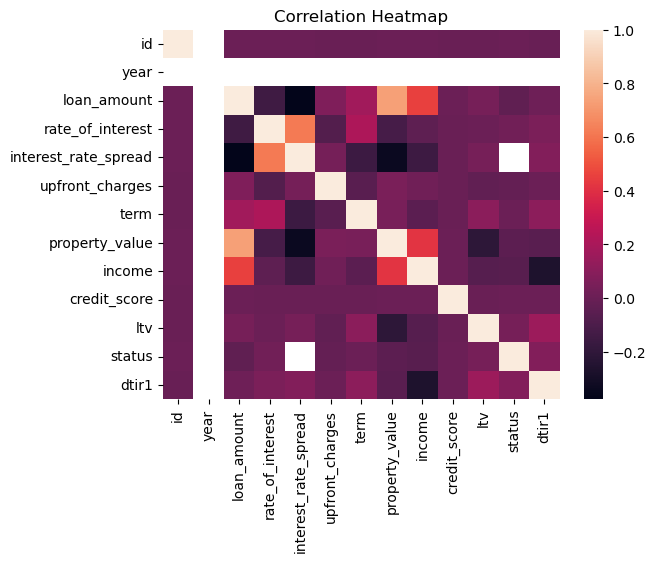

In [166]:

corr_heatmap = sns.heatmap(df.corr())
corr_heatmap.set_title("Correlation Heatmap")

Text(0, 0.5, 'Loan Amount')

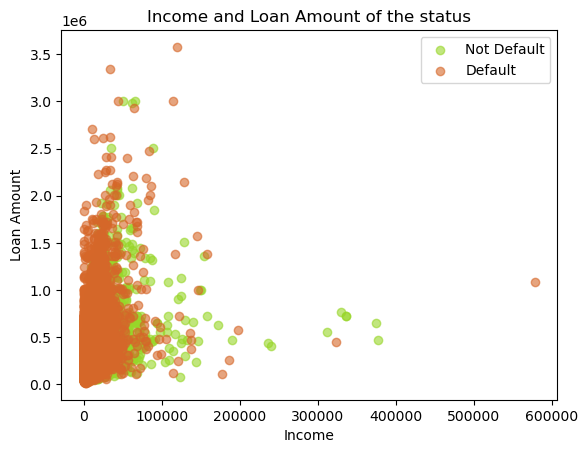

In [190]:
plt.scatter('income', "loan_amount",
            data=status_0, color='#98d629', alpha=0.6)
plt.scatter('income', "loan_amount",
            data=status_1, color='#d66729', alpha=0.6)
plt.legend(['Not Default', 'Default'])
plt.title("Income and Loan Amount of the status")
plt.xlabel("Income")
plt.ylabel("Loan Amount")

Text(0, 0.5, 'Credit Score')

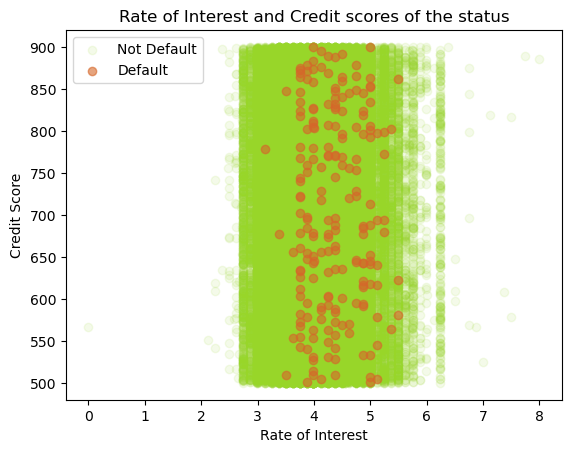

In [168]:

plt.scatter('rate_of_interest', "credit_score",
            data=status_0, color='#98d629', alpha=0.1)
plt.scatter('rate_of_interest', "credit_score",
            data=status_1, color='#d66729', alpha=0.6)
plt.legend(['Not Default', 'Default'])
plt.title("Rate of Interest and Credit scores of the status")
plt.xlabel("Rate of Interest")
plt.ylabel("Credit Score")

Text(0, 0.5, 'Income')

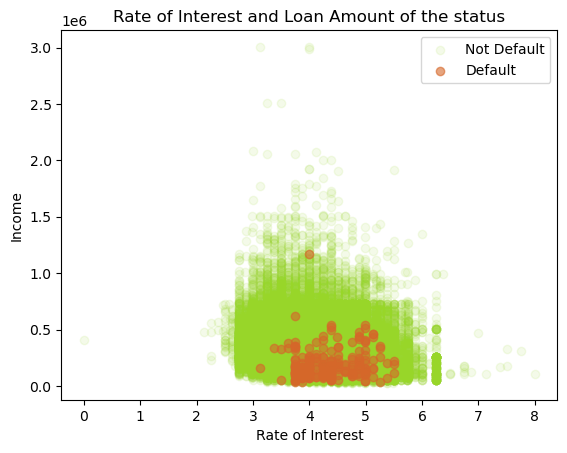

In [195]:
plt.scatter('rate_of_interest', "loan_amount",
            data=status_0, color='#98d629', alpha=0.1)
plt.scatter('rate_of_interest', "loan_amount",
            data=status_1, color='#d66729', alpha=0.6)
plt.legend(['Not Default', 'Default'])
plt.title("Rate of Interest and Loan Amount of the status")
plt.xlabel("Rate of Interest")
plt.ylabel("Income")


Text(0, 0.5, 'Interest Rate Spread')

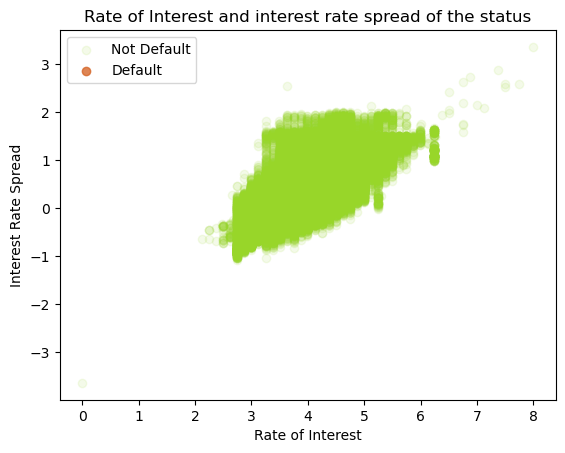

In [198]:

plt.scatter('rate_of_interest', "interest_rate_spread",
            data=status_0, color='#98d629', alpha=0.1)
plt.scatter('rate_of_interest', "interest_rate_spread",
            data=status_1, color='#d66729', alpha=0.8)
plt.legend(['Not Default', 'Default'])
plt.title("Rate of Interest and interest rate spread of the status")
plt.xlabel("Rate of Interest")
plt.ylabel("Interest Rate Spread")

Text(0, 0.5, 'Upfront Charges')

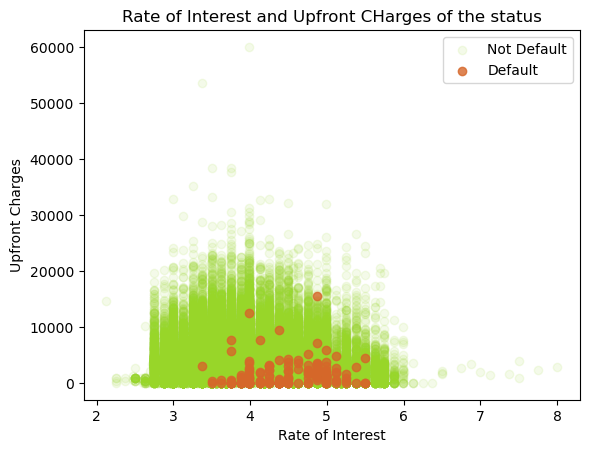

In [171]:

plt.scatter('rate_of_interest', "upfront_charges",
            data=status_0, color='#98d629', alpha=0.1)
plt.scatter('rate_of_interest', "upfront_charges",
            data=status_1, color='#d66729', alpha=0.8)
plt.legend(['Not Default', 'Default'])
plt.title("Rate of Interest and Upfront CHarges of the status")
plt.xlabel("Rate of Interest")
plt.ylabel("Upfront Charges")

In [172]:
import plotly.express as px

In [173]:
fig = px.scatter(df,x='rate_of_interest',y='interest_rate_spread',color='status')
fig.show()

In [174]:
status_1.shape

(36639, 34)

In [175]:
status_1.head()

,id,year,loan_limit,gender,approv_in_adv,loan_type,loan_purpose,credit_worthiness,open_credit,business_or_commercial,...,credit_type,credit_score,co-applicant_credit_type,age,submission_of_application,ltv,region,security_type,status,dtir1
0,24890,2019,cf,Sex Not Available,nopre,type1,p1,l1,nopc,nob/c,...,EXP,758,CIB,25-34,to_inst,98.728814,south,direct,1,45.0
1,24891,2019,cf,Male,nopre,type2,p1,l1,nopc,b/c,...,EQUI,552,EXP,55-64,to_inst,NaN,north,direct,1,NaN
10,24900,2019,cf,Male,nopre,type2,p3,l2,nopc,b/c,...,EXP,723,CIB,55-64,to_inst,81.250000,north,direct,1,44.0
12,24902,2019,cf,Joint,nopre,type2,p3,l1,nopc,b/c,...,CRIF,884,EXP,65-74,to_inst,80.038760,north,direct,1,51.0
15,24905,2019,cf,Male,nopre,type1,p4,l1,nopc,nob/c,...,EXP,685,CIB,45-54,not_inst,55.434783,north,direct,1,20.0


In [176]:

df.approv_in_adv = df.approv_in_adv.replace("pre",1)
df.approv_in_adv = df.approv_in_adv.replace("nopre",0)
df.open_credit = df.open_credit.replace("opc",1)
df.open_credit = df.open_credit.replace("nopc",0)
df.business_or_commercial = df.business_or_commercial.replace("b/c",1)
df.business_or_commercial = df.business_or_commercial.replace("nob/c",0)
df.neg_ammortization = df.neg_ammortization.replace("neg_amm",1)
df.neg_ammortization = df.neg_ammortization.replace("not_neg",0)
df.interest_only = df.interest_only.replace("int_only",1)
df.interest_only = df.interest_only.replace("not_int",0)
df.lump_sum_payment = df.lump_sum_payment.replace("lpsm",1)
df.lump_sum_payment = df.lump_sum_payment.replace("not_lpsm",0)
df.submission_of_application = df.submission_of_application.replace("to_inst",1)
df.submission_of_application = df.submission_of_application.replace("not_inst",0)

# Conclusion

